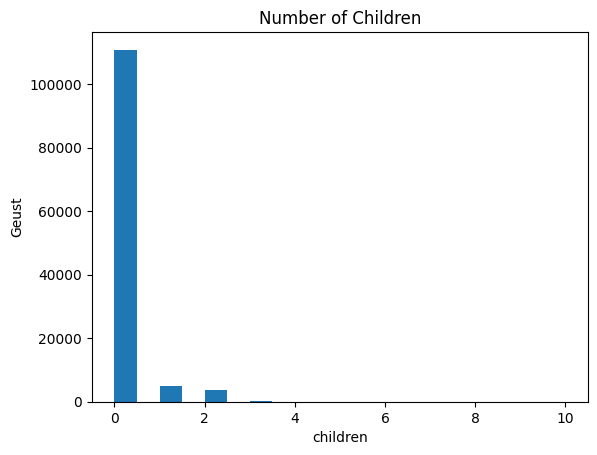

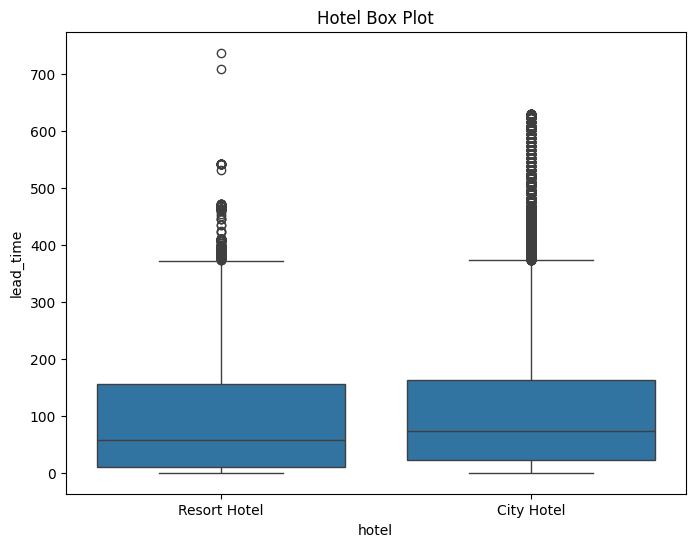

Loading BokehJS ...

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from plotly import express as px

# path for csv 
file_path = 'hotel_bookings.csv'
na_values_array = ['undefined',  'none']
# Read the CSV file into a DataFrame
df = pd.read_csv(file_path, na_values= na_values_array)


#Update columns to the right dtype (reservation_status_date to datetime and is_canceled to bool)
df['reservation_status_date'] = pd.to_datetime(df['reservation_status_date'])
#df['reservation_status_date'] = df['reservation_status_date'].astype('datetime')
df['is_canceled'] = df['is_canceled'].astype('bool')

#In a new column named 'arrival_date', connect the year, month and day of month to one neat datetime - you will need to convert the columns
#to strings first
df['arrival_date'] = df.apply(lambda row: pd.to_datetime(f"{row['arrival_date_year']}-{row['arrival_date_month']}-{row['arrival_date_day_of_month']}", errors='coerce'), axis=1)

#In a new col named 'direct_booking' fill with 'yes' if agent and company are NaN values, else fill with no.
df['direct_booking']= df.apply(lambda row: 'yes' if pd.isna(row['agent']) and pd.isna(row['company']) else 'no', axis=1)

#viz one- pandas histogram how many people have children 
df['children'].plot(kind='hist', bins=20)
plt.title('Number of Children')
plt.xlabel('children')
plt.ylabel('Geust')
plt.show()

#viz 2 - boxplot using seaborn and matplotlib
plt.figure(figsize=(8, 6))
sns.boxplot(x='hotel', y='lead_time', data=df)
plt.title('Hotel Box Plot')
plt.show()

#viz 3- mean and mode using a bar plot 
mean_lead_time_int = df.groupby('hotel')['lead_time'].mean()
mode_lead_time_int = df.groupby('hotel')['lead_time'].apply(lambda x: x.mode().tolist())
comb_df = pd.DataFrame({'Mean': mean_lead_time, 'Mode': mode_lead_time}).reset_index()
melted_df = pd.melt(comb_df, id_vars=['hotel'], value_vars=['Mean', 'Mode'])
fig = px.bar(melted_df, x='hotel', y='value', color='variable',
             labels={'value': 'Lead Time', 'variable': 'Statistic'},
             title='Mean and Mode of Lead Time by Hotel',
             category_orders={'hotel': sorted(comb_df['hotel'].unique())},
             barmode='group')

fig.show()


#viz 4- bokeh scatterplot shows correlation between number of children and cars
output_notebook()
p = figure(title='Scatter Plot', x_axis_label='Children', y_axis_label='Cars')
p.scatter(x='children', y='required_car_parking_spaces', size=10, color='navy', alpha=0.6, source=df)

show(p)













In [2]:
pip install sqlalchemy

You should consider upgrading via the 'c:\Users\chaya\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.
